In [1]:
import sys
import torch as t
import numpy as np
from matplotlib import pyplot as plt
import json
from itertools import product
sys.path.append('/workspace/wilson/Finite-groups/src')
from model import MLP3, MLP4, InstancedModule
from evals import load_models
from utils import *
from group_data import *
from jaxtyping import Float
from typing import Union
from einops import repeat
from torch.utils.data import DataLoader
from tqdm.notebook import tqdm
import plotly.graph_objects as go
import copy
import math
from itertools import product
from llc import *
%load_ext autoreload
%autoreload 2

In [2]:
device = t.device("cuda" if t.cuda.is_available() else "cpu")

In [4]:
#path = '/workspace/models/2024_08_02_02_17_18_S_5_'
#path = '/workspace/models/2024_08_03_00_04_30_Z_48_2_'
#path = '/workspace/models/2024_08_04_00_13_28_Z_48_2__twZ_48_'
#path = '/workspace/models/2024_08_03_21_29_50_Z_48_2__MLP4_512'
path = '/workspace/models/2024_08_05_18_31_53_S_5__times_A_5__Z_2__'
models, params = load_models(path, final=True)

100%|██████████| 1/1 [00:00<00:00,  1.71it/s]


In [5]:
dataset = GroupData(params)

Intersection size: 7920/14400 (0.55)
Added 7920 elements from intersection
Added 0 elements from group 0: S(5)
Added 0 elements from group 1: times(A(5),Z(2))
Train set size: 7920/14400 (0.55)


In [7]:
#model0 = models[10][1].to(device)
model1 = models[-1][1].to(device)

In [17]:
#eps_l = [1.3**m for m in range(-80, -20)]
#eps_l = [1e-4, 3e-4, 1e-3, 3e-3, 1e-2]
eps_l = [1e-4 * x for x in range(1, 10)] + [1e-3 * x for x in range(1, 10)]
#eps_l = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2]
#beta_l = [1e2, 1e3]
beta_l = [1e2, 1e3, 1e4, 1e5]
gamma_l = [1.]
llc1, trace1 = sweep_llc(
    model1, dataset, eps_l, beta_l, gamma_l, chains=1, epochs=2_000, replacement=False, behavioral=False,#batch_size=128,
)

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

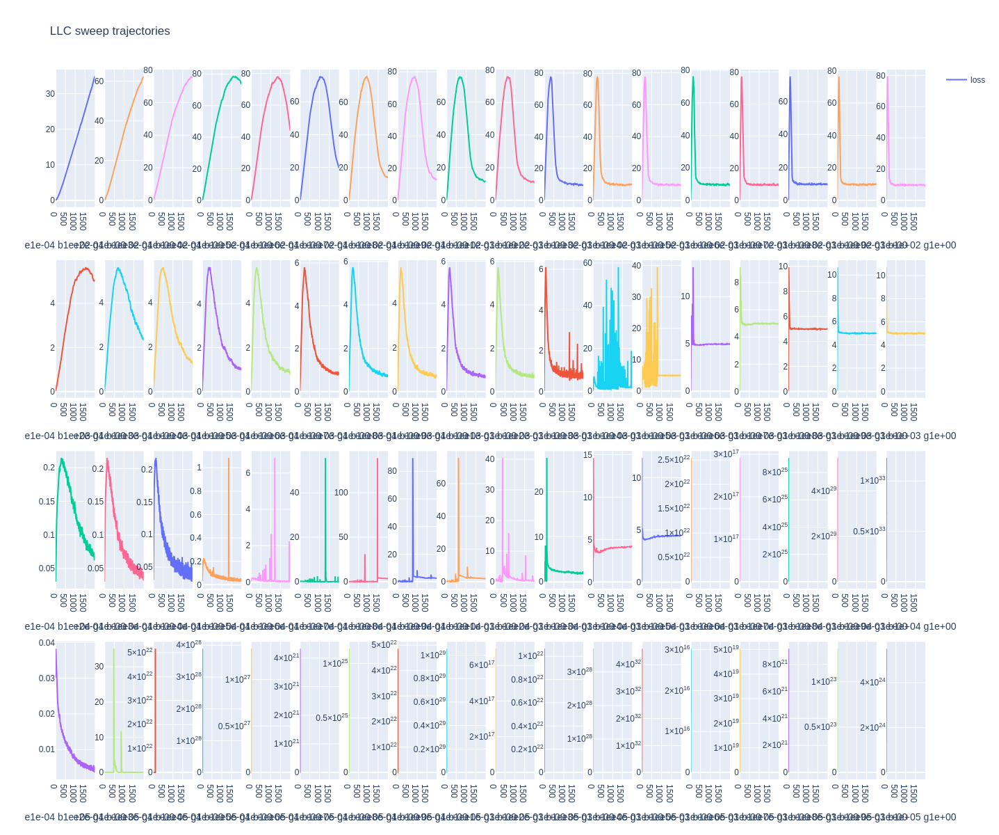

In [18]:
plot_trace_sweep(trace1, eps_l, beta_l, gamma_l).show()

In [8]:
llc0, trace0 = sweep_llc(
    model0, dataset, eps_l, beta_l, gamma_l, chains=5, epochs=3_000, replacement=False, behavioral=False,
)

SGLD:   0%|          | 0/3000 [00:00<?, ?it/s]

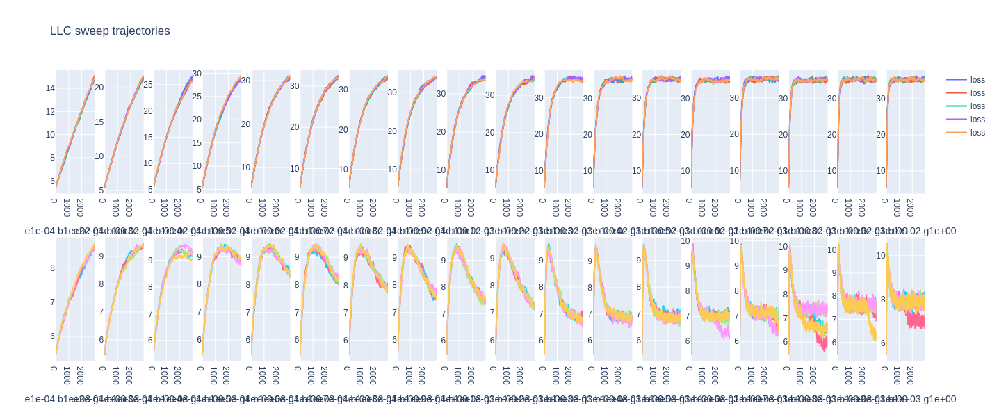

In [9]:
plot_trace_sweep(trace0, eps_l, beta_l, gamma_l).show()

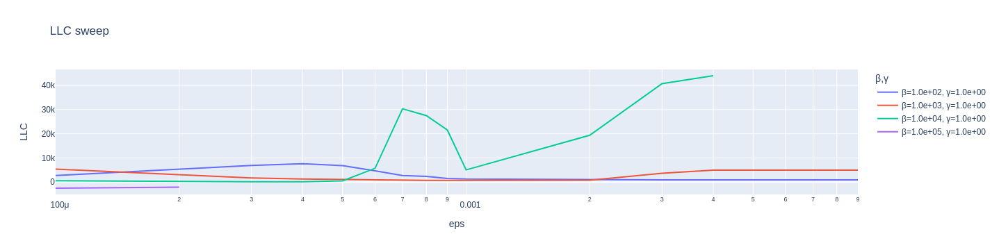

In [19]:
plot_llc_sweep(llc1, eps_l, beta_l, gamma_l)

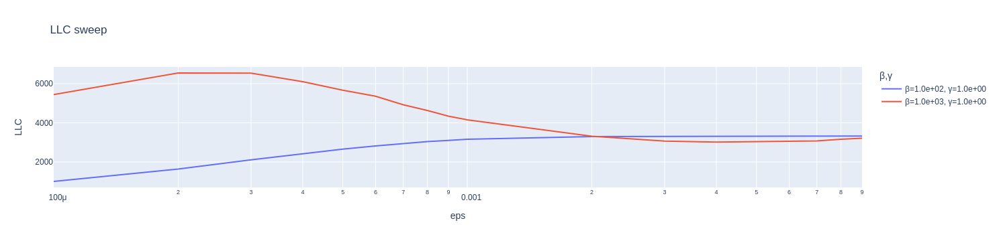

In [11]:
plot_llc_sweep(llc1, eps_l, beta_l, gamma_l)

In [71]:
model = model0.to(device)

In [18]:
from devinterp.slt import sample, LLCEstimator
from devinterp.optim import SGLD
from devinterp.utils import optimal_temperature

In [20]:
X = t.tensor(list(dataset.train_data))[:, :2].to(device)  # (train_size, 2)
# TODO: will need to batch model(X) for larger models/groups
Y = model1(X).clone().detach()  # (train_size, instances, group_size)
b_data = TensorDataset(X, Y.squeeze(1))
loader = DataLoader(dataset=b_data, batch_size=len(dataset), shuffle=False)

In [22]:
kl = lambda x, y: (y.softmax(dim=1) * (y.log_softmax(dim=1) - x.squeeze(1).log_softmax(dim=1))).sum(-1).mean()   # need to squeeze out instance dimension

In [26]:
optim_kwargs = {
    'lr': 3e-3, 'localization': 1., 'temperature': 1e3
}
num_draws = 1_000
estimator = LLCEstimator(num_chains=1, num_draws=num_draws, temperature=optim_kwargs['temperature'])
sample(
    model1, loader, callbacks=[estimator], criterion=kl, num_chains=1, num_draws=num_draws, optimizer_kwargs=optim_kwargs
)

Chain 0: 100%|██████████| 1000/1000 [00:38<00:00, 25.73it/s]


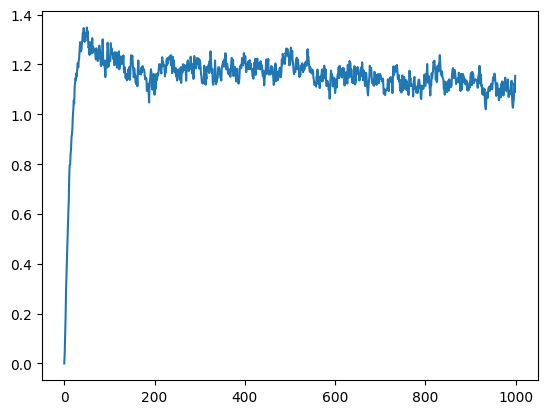

In [27]:
plt.plot(estimator.sample()['loss/trace'].flatten())
plt.show()

In [7]:
model_traj.num_instances()

1334

In [52]:
import gc
gc.collect()
t.cuda.empty_cache()

805

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

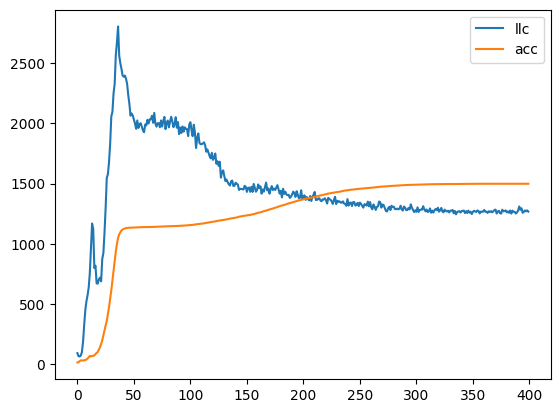

In [53]:
model_traj = MLP3.stack([model[85].to(device) for model in models[:]])
model_traj = model_traj[:400]
bllc = get_llc(
    model_traj, dataset, eps=3e-3, beta=1e3, gamma=1., chains=9, cbatch_size=3, replacement=False, behavioral=True, epochs=2000, burnin=0.8
)
loss_dict = test_loss(model_traj, dataset)


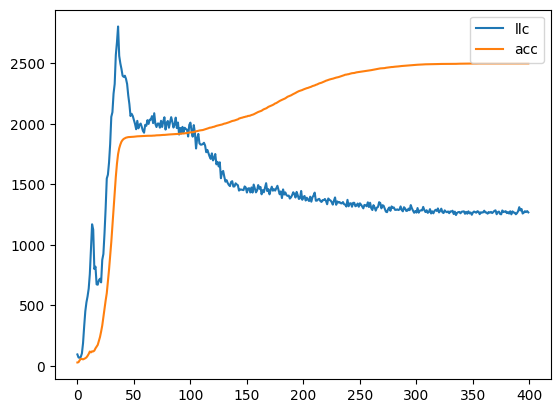

In [55]:
plt.plot(bllc.tolist(), label='llc')
plt.plot((loss_dict['G0_acc'].detach().cpu().numpy() * 2500).tolist(), label='acc')
plt.legend()
plt.show()

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

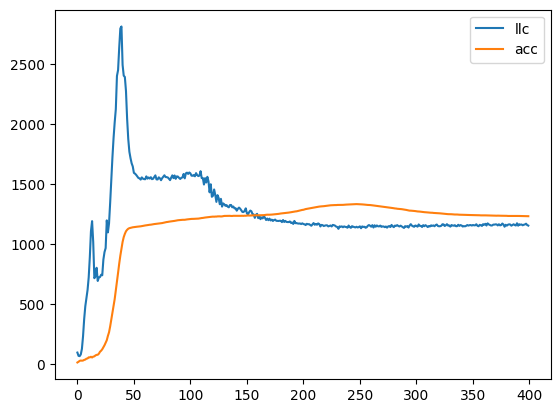

In [57]:
import gc
gc.collect()
t.cuda.empty_cache()
model_traj = MLP3.stack([model[84].to(device) for model in models[:]])
model_traj = model_traj[:400]
bllc = get_llc(
    model_traj, dataset, eps=3e-3, beta=1e3, gamma=1., chains=9, cbatch_size=3, replacement=False, behavioral=True, epochs=2000, burnin=0.8
)
loss_dict = test_loss(model_traj, dataset)
plt.plot(bllc.tolist(), label='llc')
plt.plot((loss_dict['G0_acc'].detach().cpu().numpy() * 1500).tolist(), label='acc')
plt.legend()
plt.show()

SGLD:   0%|          | 0/4000 [00:00<?, ?it/s]

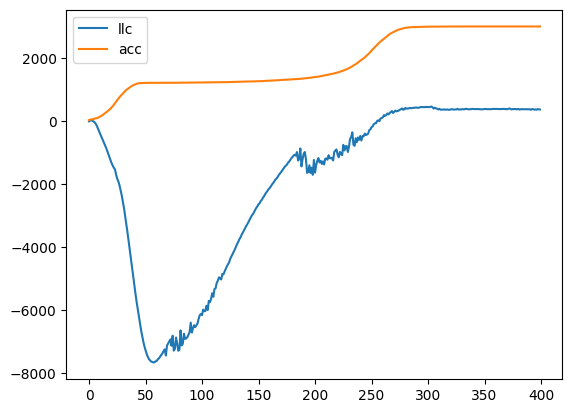

In [11]:
llc, _ = get_llc(
    model_traj, dataset, eps=3e-3, beta=1e3, gamma=1., chains=3, replacement=False, behavioral=False, parallel_chain=True, epochs=4000, burnin=0.8
)

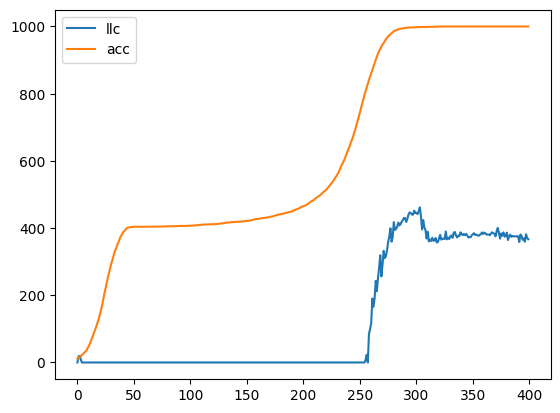

In [20]:
plt.plot(t.maximum(llc, t.zeros_like(llc)).tolist(), label='llc')
plt.plot((loss_dict['G0_acc'].detach().cpu().numpy() * 1000).tolist(), label='acc')
plt.legend()
plt.show()

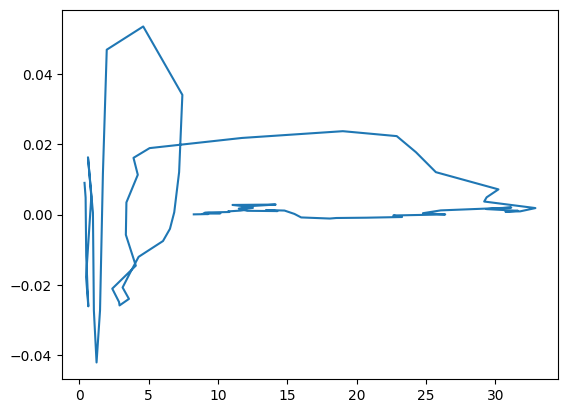

In [80]:
plt.plot(llc[:80], np.gradient(np.gradient(loss[:80].tolist())))

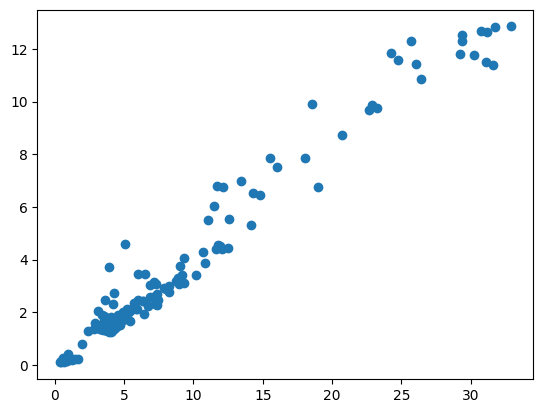

In [59]:
plt.scatter(llc.detach().cpu().numpy(), llc_square.detach().cpu().numpy())

In [60]:
llc = llc.detach().cpu().numpy()
llc_square = llc_square.detach().cpu().numpy()

In [62]:
(llc * llc_square).sum() / (llc**2).sum()

np.float32(0.41292116)

In [63]:
np.corrcoef(llc, llc_square)

array([[1.        , 0.98457619],
       [0.98457619, 1.        ]])

In [35]:
llc[20]

tensor(-63.0355, device='cuda:0', grad_fn=<SelectBackward0>)

In [111]:
plt.plot

torch.Size([667])

In [31]:
del model_traj

In [32]:
del llc

In [33]:
import gc
t.cuda.empty_cache()
gc.collect()

4103

In [28]:
path = '/workspace/models/2024_07_31_03_48_41_Z_48_2__long'
models, params = load_models(path)
model0 = models[0].to(device)

100%|██████████| 1/1 [00:00<00:00, 10.07it/s]


In [29]:
params.group_string = 'Z(48,2);twZ(48)'
params.train_frac=1.
params.delta_frac=[0.,0.]

In [30]:
dataset = GroupData(params)

Intersection size: 6912/9216 (0.75)
Added 6912 elements from intersection
Added 0 elements from group 0: Z(48,2)
Added 0 elements from group 1: twZ(48)
Train set size: 6912/9216 (0.75)


In [ ]:
llc0, _ = get_llc(
    model0, dataset, eps=3e-3, beta=1e3, gamma=1.0, chains=5, replacement=False, positive=False, behavioral=True, parallel_chain=True,
)

In [32]:
path = '/workspace/models/2024_07_31_04_29_56_twZ_48__long'
models, params = load_models(path)
model1 = models[0].to(device)

100%|██████████| 1/1 [00:00<00:00,  9.34it/s]


In [39]:
llc1, _ = get_llc(
    model1, dataset, eps=3e-3, beta=1e3, gamma=1.0, chains=5, replacement=False, positive=False, behavioral=True, parallel_chain=True,
)

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

In [36]:
train_loss0 = full_train_loss(model0, dataset)
train_loss1 = full_train_loss(model1, dataset)

In [40]:
llc0.mean()

tensor(1264.9438, device='cuda:0')

In [41]:
llc1.mean()

tensor(1940.5132, device='cuda:0')

In [44]:
llc1.max()

tensor(2643.6138, device='cuda:0')

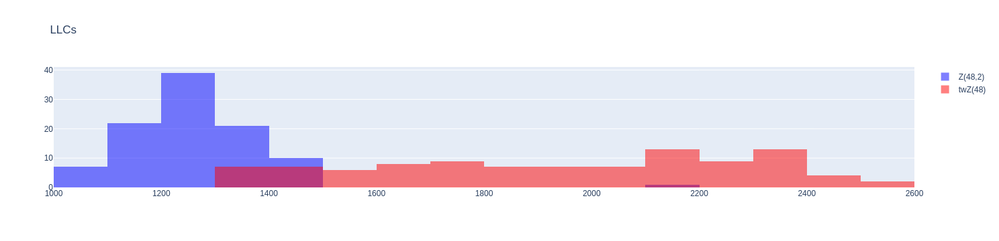

In [45]:
xbins = dict(
    start=1000,
    end=2600,
    size=100
)
trace1 = go.Histogram(
    x=llc0.tolist(),
    opacity=0.5,
    name='Z(48,2)',
    marker=dict(color='blue'),
    xbins=xbins,
)
trace2 = go.Histogram(
    x=llc1.tolist(),
    opacity=0.5,
    name='twZ(48)',
    marker=dict(color='red'),
    xbins=xbins
)
data = [trace1, trace2]
layout = go.Layout(
    title='LLCs',
    barmode='overlay'
)
fig = go.Figure(data=data, layout=layout)
fig.show()

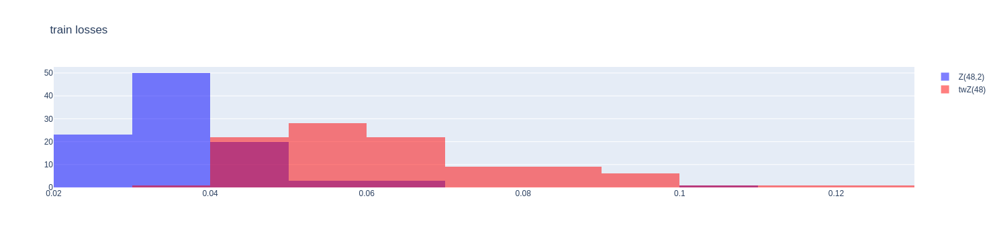

In [41]:
xbins = dict(
    start=0,
    end=0.2,
    size=0.01
)
trace1 = go.Histogram(
    x=train_loss0.tolist(),
    opacity=0.5,
    name='Z(48,2)',
    marker=dict(color='blue'),
    xbins=xbins,
)
trace2 = go.Histogram(
    x=train_loss1.tolist(),
    opacity=0.5,
    name='twZ(48)',
    marker=dict(color='red'),
    xbins=xbins
)
data = [trace1, trace2]
layout = go.Layout(
    title='train losses',
    barmode='overlay'
)
fig = go.Figure(data=data, layout=layout)
fig.show()

In [40]:
max(train_loss0)

tensor(0.1020, device='cuda:0', grad_fn=<UnbindBackward0>)

In [58]:
len(models)

1334

In [61]:
bllc = get_llc(
    models[-1].to(device), dataset, eps=3e-3, beta=1e3, gamma=1., chains=3, cbatch_size=-1, replacement=False, behavioral=True, epochs=2000, burnin=0.8
)

SGLD:   0%|          | 0/2000 [00:00<?, ?it/s]

In [63]:
loss_dict = test_loss(models[-1].to(device), dataset)

In [70]:
train_loss = full_train_loss(models[-1].to(device), dataset)

Text(0.5, 1.0, 'Z(48,2);twZ(48) LLC vs G0 acc')

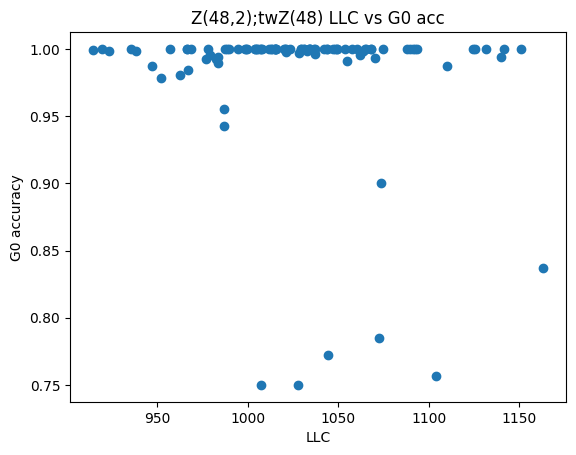

In [79]:
plt.scatter(bllc.tolist(), loss_dict['G0_acc'].tolist())
plt.xlabel('LLC')
plt.ylabel('G0 accuracy')
plt.title('Z(48,2);twZ(48) LLC vs G0 acc')

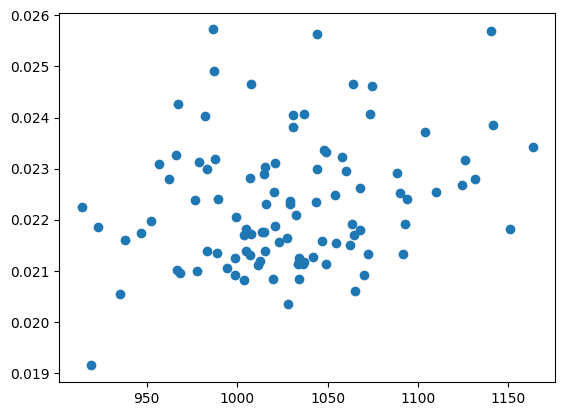

In [71]:
plt.scatter(bllc.tolist(), train_loss.tolist())